# Exploratory Analysis of Eviction data

For my last assignment I looked at rent burden across multiple years for Los Angeles county. Now that I have a better understanding of the different variables of interest related to eviction, I want to spend this assignment combining the techniques we've learned in class so far, and do some deeper descriptions of different datasets I've found online. Namely, I want to look at the eviction notice file from the LA Controller's office website and plot this overlaid against different population characteristics spatially.

In the articles recommended by Chris and in our own literature review, we identified rent as % of income, lack of a high school diploma, race, income, and greater than 20 units in a building as contributory variables to eviction. 

In [1]:
# Import required packages
import geopandas as gpd
import pandas as pd
import folium as fm
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl
import re
import plotly.express as px
import statistics

## Importing Data
So far there are four datasets getting merged: Neighborhood boundaries with polygons and names, census tract file, original eviction filing notices retrieved from LA controller's website, and the geocoded addresses.

In [2]:
neighborhoods = gpd.read_file('data/LA_Times_Neighborhood_Boundaries.geojson')
ct_la = gpd.read_file('data/Census_Tracts_2020.geojson')
evictions = pd.read_csv('data/2023_Eviction_Notices.csv')
evictions_geocode = pd.read_csv('data/output.csv')
cdem_la = pd.read_csv('data/ACS2022.S0601.csv', low_memory=False,
                     dtype={
                         'FIPS':str
                     })
chous_la = pd.read_csv('data/ACS2022.DP04.csv',low_memory=False,
                       dtype={
                           'FIPS':str
                       })

ERROR 1: PROJ: proj_create_from_database: Open of /opt/conda/share/proj failed


## Eviction Data
### Merge Eviction and geocoded data

Here I prep the eviction files for merging. I change the names of the columns to match each other and make sure they're strings.

I don't merge on a column because the index of each dataframe remain identical from the geocoding process, and the shape of each dataframe don't match given the number of available addresses.

In [3]:
# Convert evictions 'Address' to string
evictions['Address'] = evictions['Address'].astype(str)

# Create new column in evictions_geocode with matching name 'Address' and make sure it's a string
evictions_geocode['Address'] = evictions_geocode['input_string'].astype(str)

# Merge the two dataframes 
evictions_matched = evictions_geocode.merge(evictions,left_index=True, right_index=True)

Let's check the work

In [4]:
evictions_matched.head(20)

,Unnamed: 0,formatted_address,latitude,longitude,accuracy,google_place_id,type,postcode,input_string,number_of_results,...,Eviction Category,Cause,Address_y,City,Zip,Bedroom,Notice Type,Apn,Council District,Rent Owed
0,0,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,7367 Hollywood Blvd,1,...,At-Fault,Non-payment of rent,7367 Hollywood Blvd,Los Angeles,90046,NaN,3 Day,5550001030,4,"$1,850.00"
1,1,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,7367 Hollywood Blvd,1,...,At-Fault,Non-payment of rent,7367 Hollywood Blvd,Los Angeles,90046,NaN,3 Day,5550001030,4,"$1,866.78"
2,2,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,7367 Hollywood Blvd,1,...,At-Fault,Non-payment of rent,7367 Hollywood Blvd,Los Angeles,90046,NaN,3 Day,5550001030,4,"$1,800.00"
3,3,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,7367 Hollywood Blvd,1,...,At-Fault,Non-payment of rent,7367 Hollywood Blvd,Los Angeles,90046,NaN,3 Day,5550001030,4,"$1,500.00"
4,4,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,7367 Hollywood Blvd,1,...,At-Fault,Non-payment of rent,7367 Hollywood Blvd,Los Angeles,90046,NaN,3 Day,5550001030,4,"$1,742.97"
5,5,"1212 N Edgemont St, Los Angeles, CA 90029, USA",34.093862,-118.295827,ROOFTOP,ChIJBy6D-lTHwoARYd-DB34sGnQ,premise,90029,1212 N. Edgemont St.,1,...,At-Fault,"Non-payment of rent, Violation of the rental a...",1212 N. Edgemont St.,Los Angeles,90029,NaN,3 Day,5540012006,13,"$1,105.74"
6,6,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,7367 Hollywood Blvd,1,...,At-Fault,Non-payment of rent,7367 Hollywood Blvd,Los Angeles,90046,NaN,3 Day,5550001030,4,"$1,768.00"
7,7,"5346 VA Oss, Netherlands",51.776799,5.514597,APPROXIMATE,ChIJi6Fddm_8xkcRZ3Ihhsn-ZJo,postal_code,5346 VA,5346 Virginia,1,...,At-Fault,Non-payment of rent,5346 Virginia,Los Angeles,90029,NaN,3 Day,5537008002,13,"$3,850.00"
8,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8157 Kirkwood Drive,0,...,At-Fault,Non-payment of rent,8157 Kirkwood Drive,Los Angeles,90046,NaN,3 Day,5567028011,4,"$4,500.00"
9,9,"Tyrone Ave, Penns Grove, NJ 08069, USA",39.725760,-75.469781,GEOMETRIC_CENTER,ChIJR3WTpnrixokRIN1D1f7ZSNY,route,08069,8069 Tyrone Ave,1,...,At-Fault,Non-payment of rent,8069 Tyrone Ave,Panorama City,91402,NaN,3 Day,2212011018,6,"$2,390.00"


### Process the matched file

The geocoding process wasn't perfect and ended up gathering coordinates from addresses outside of LA. On top of this, some of the 'postcode' values contain letters which complicates processing. Therefore, I decided to convert the series into strings, use regular expressions to remove all letters from each row, drop the null values, and convert it back to numeric for further processing.

In [5]:
# Convert postcode values to strings
evictions_matched.postcode = evictions_matched.postcode.astype(str)

# Remove all non numeric characters 
evictions_matched['postcode'] = evictions_matched['postcode'].str.replace("[^0-9]","",regex=True)

# Drop null values
evictions_matched.postcode = evictions_matched.postcode.dropna()

# Convert postcode back to numeric
evictions_matched['postcode'] = pd.to_numeric(evictions_matched['postcode'])

Now I have to remove the addresses that aren't in LA. The zip codes of LA range from 90001 to 93599 so the below code removes any records with a 'postcode' value not within that range.

In [6]:
evictions_matched = evictions_matched.drop(evictions_matched[(evictions_matched.postcode < 90001)].index)
evictions_matched = evictions_matched.drop(evictions_matched[(evictions_matched.postcode > 93600)].index)

In [7]:
evic_geo_match = gpd.GeoDataFrame(evictions_matched,geometry=gpd.points_from_xy(evictions_matched['longitude'],evictions_matched['latitude']),crs='4326')

Just another double-check that things are going ok.

In [8]:
evic_geo_match.columns

Index(['Unnamed: 0', 'formatted_address', 'latitude', 'longitude', 'accuracy',
       'google_place_id', 'type', 'postcode', 'input_string',
       'number_of_results', 'status', 'Address_x', 'Notice Date',
       'Date Received', 'Eviction Category', 'Cause', 'Address_y', 'City',
       'Zip', 'Bedroom', 'Notice Type', 'Apn', 'Council District', 'Rent Owed',
       'geometry'],
      dtype='object')

In [9]:
evic_geo_match.columns

Index(['Unnamed: 0', 'formatted_address', 'latitude', 'longitude', 'accuracy',
       'google_place_id', 'type', 'postcode', 'input_string',
       'number_of_results', 'status', 'Address_x', 'Notice Date',
       'Date Received', 'Eviction Category', 'Cause', 'Address_y', 'City',
       'Zip', 'Bedroom', 'Notice Type', 'Apn', 'Council District', 'Rent Owed',
       'geometry'],
      dtype='object')

Let's convert the Notice Date column to datetime to be able to manipulate it easier.

In [10]:
evic_geo_match['Notice Date'] = pd.to_datetime(evic_geo_match['Notice Date'])
evic_geo_match['Notice Date']

0       2023-02-03
1       2023-02-03
2       2023-02-03
3       2023-02-03
4       2023-02-03
           ...    
52185   2023-08-07
52186   2023-08-17
52188   2023-08-22
52190   2023-05-01
52191   2023-08-23
Name: Notice Date, Length: 46458, dtype: datetime64[ns]

In [11]:
evic_geo_match = evic_geo_match[evic_geo_match['Notice Date'].dt.year >= 2023 ]
evic_geo_match['Notice Date'].max(), evic_geo_match['Notice Date'].min()

(Timestamp('2023-09-30 00:00:00'), Timestamp('2023-01-01 00:00:00'))

Unfortunately it looks like I'll have to rerun the geocoding process, since it was only able to grab 50k of the 70k or so filings for the whole year. This subset I got seems to be continuous from February to September 2023 with a few stray 2022 rows which I've opted to delete. 

Below I want to get the addresses and the number of filings at each address and store it as a string.

In [12]:
address_count = evic_geo_match.value_counts('formatted_address').reset_index(name='count')
address_count['formatted_address'] = address_count['formatted_address'].astype(str)

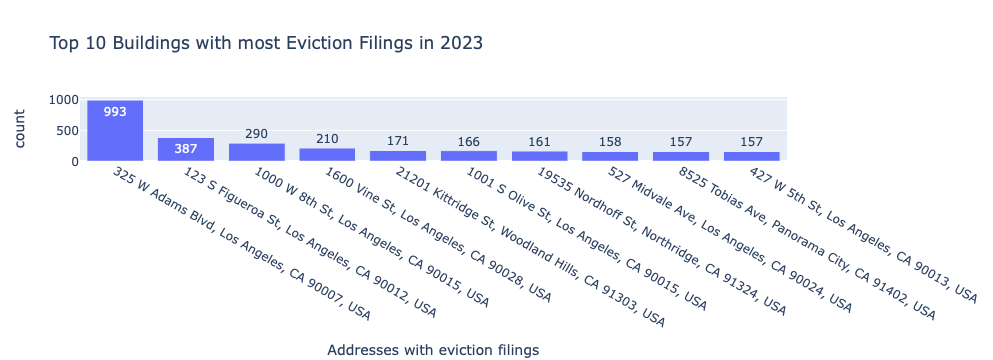

In [13]:
# I'm interested in seeing if there are particular buildings with high rates of evictions
fig = px.bar(
    address_count.head(10),
    x='formatted_address',
    y='count',
    title='Top 10 Buildings with most Eviction Filings in 2023',
    labels={
        'formatted_address':'Addresses with eviction filings'
    },
    text='count'
)
fig.show()

I found this [article](https://www.latimes.com/california/story/2023-09-07/over-40-000-eviction-notices-have-gone-out-in-la-this-year-many-to-upscale-apartments) after I did all of this work and got sad, but at least I can do a few newer things. Not sure what happened with 325 w Adams Blvd but does not seem like an accurate count.

For now I want to plot the evictions over time.

In [14]:
address_count_grpd = evic_geo_match.value_counts(['Notice Date']).reset_index(name='count')
address_count_grpd

,Notice Date,count
0,2023-03-08,1626
1,2023-04-05,1618
2,2023-04-06,1494
3,2023-05-04,1415
4,2023-04-07,1409
...,...,...
216,2023-08-20,1
217,2023-01-05,1
218,2023-01-25,1
219,2023-01-28,1


In [15]:
address_count_grpd_june = address_count_grpd[address_count_grpd['Notice Date'].dt.month == 6]
address_count_grpd_june

,Notice Date,count
7,2023-06-06,1111
11,2023-06-07,964
15,2023-06-05,790
29,2023-06-08,473
36,2023-06-09,382
43,2023-06-13,335
44,2023-06-02,334
52,2023-06-14,263
59,2023-06-15,204
67,2023-06-16,168


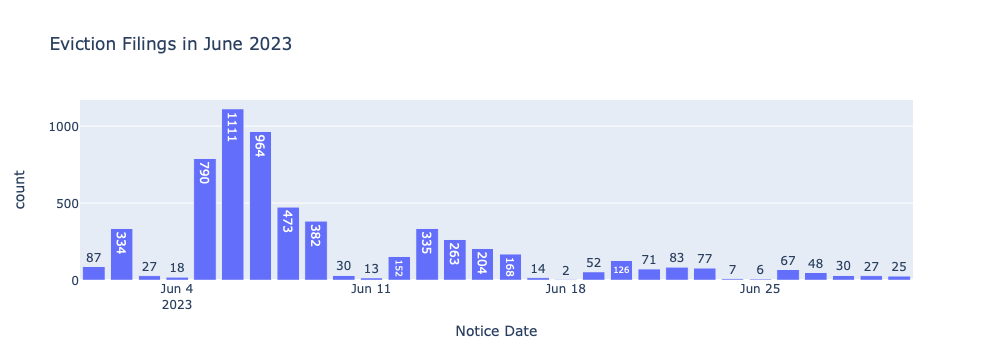

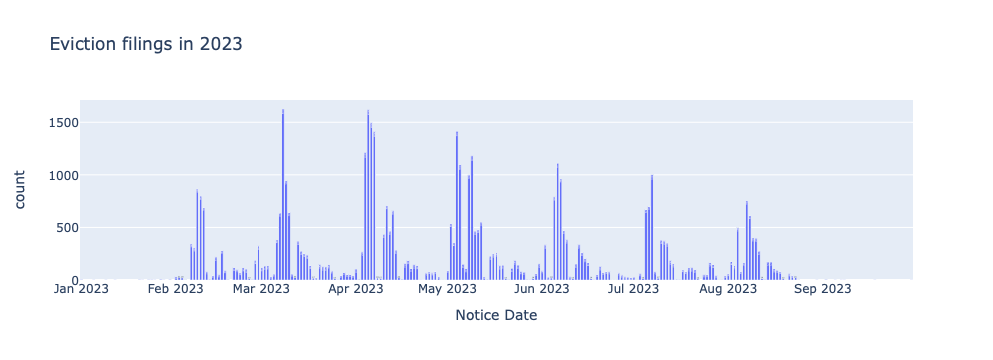

(None, None)

In [16]:
# a simple bar chart, putting date on the x-axis
fig_date_june = px.bar(
    address_count_grpd_june,
    x='Notice Date',
    y='count',
    text='count',
    title='Eviction Filings in June 2023'
)

fig_date_year = px.bar(
    address_count_grpd,
    x = 'Notice Date',
    y='count',
    text='count',
    title='Eviction filings in 2023'
)
fig_date_june.show(),fig_date_year.show()

Seems like most filings happen in the beginning of the month. There's also a weird decrease over the year with each month for some reason. 

## Process Census tract and neighborhood files

### Peep the data

In [17]:
neighborhoods.describe

<bound method NDFrame.describe of      OBJECTID                    name  \
0           1         Adams-Normandie   
1           2                  Arleta   
2           3       Arlington Heights   
3           4         Atwater Village   
4           5  Baldwin Hills/Crenshaw   
..        ...                     ...   
109       110              Wilmington   
110       111          Windsor Square   
111       112                Winnetka   
112       113          Woodland Hills   
113       114             Lake Balboa   

                                              geometry  
0    POLYGON ((-118.30069 34.03731, -118.30388 34.0...  
1    POLYGON ((-118.44255 34.26412, -118.44240 34.2...  
2    POLYGON ((-118.31862 34.05306, -118.31673 34.0...  
3    MULTIPOLYGON (((-118.27886 34.15321, -118.2788...  
4    POLYGON ((-118.36102 34.02532, -118.36026 34.0...  
..                                                 ...  
109  MULTIPOLYGON (((-118.28331 33.75532, -118.2880...  
110  POLYGON ((-1

In [18]:
ct_la.head()

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry
0,1,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.28491 34.25948, -118.28492 34.2..."
1,2,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.29015 34.27417, -118.29015 34.2..."
2,3,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.28100 34.25592, -118.28198 34.2..."
3,4,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2..."
4,5,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25405, -118.28594 34.2..."


<Axes: >

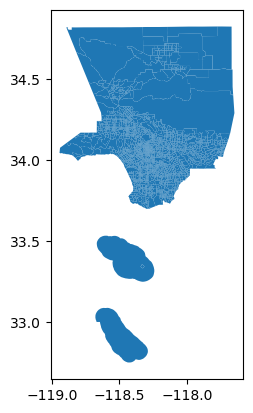

In [19]:
ct_la.plot()

### Create FIPS column

In [20]:
# Convert CRS to 4326
ct_la = ct_la.to_crs(4326)

# Convert the census tract codes to strings and store them in a new column for FIPS
ct_la['FIPS'] = ct_la['CT20'].astype(str)

# Add the state and county code to the individual census tract codes
ct_la['FIPS'] = '06037' + ct_la['FIPS']

# Check our work
ct_la['FIPS'].head()

0    06037101110
1    06037101122
2    06037101220
3    06037101221
4    06037101222
Name: FIPS, dtype: object

### Merge the datasets together 

In [68]:
ntd_la = ct_la.merge(cdem_la,on='FIPS')
ntdh_la = chous_la.merge(ntd_la,on='FIPS')

In [69]:
ntdh_la = gpd.GeoDataFrame(ntdh_la,geometry='geometry')

In [70]:
n_ntdh_la = gpd.sjoin(ntdh_la, neighborhoods, how='inner')

In [72]:
n_ntdh_la = n_ntdh_la[[
    'geometry',
    'FIPS',
    'name',
    'DP04_0012E',
    'DP04_0013E',
    'DP04_0136E',
    'DP04_0137E',
    'DP04_0138E',
    'DP04_0139E',
    'DP04_0140E',
    'DP04_0141E',
    'DP04_0142E',
    'DP04_0137PE',
    'DP04_0138PE',
    'DP04_0139PE',
    'DP04_0140PE',
    'DP04_0141PE',
    'DP04_0142PE',
    'S0601_C01_049E',
    'S0601_C01_050E',
    'S0601_C01_014E',
    'S0601_C01_015E',
    'S0601_C01_016E',
    'S0601_C01_017E',
    'S0601_C01_018E',
    'S0601_C01_019E',
    'S0601_C01_020E',
    'S0601_C01_033E',
]].copy()

n_ntdh_la = n_ntdh_la.rename(columns={
    'DP04_0012E':'units10_19',
    'DP04_0013E':'units20_more',
    'DP04_0136E':'total_renter',
    'DP04_0137E':'GRAPI_less_15',
    'DP04_0138E':'GRAPI_15_19',
    'DP04_0139E':'GRAPI_20_24',
    'DP04_0140E':'GRAPI_25_29',
    'DP04_0141E':'GRAPI_30_34',
    'DP04_0142E':'GRAPI_m_35',
    'DP04_0137PE':'GRAPI_less_15p',
    'DP04_0138PE':'GRAPI_15_19p',
    'DP04_0139PE':'GRAPI_20_24p',
    'DP04_0140PE':'GRAPI_25_29p',
    'DP04_0141PE':'GRAPI_30_34p',
    'DP04_0142PE':'GRAPI_m_35p',
    'S0601_C01_049E':'fpl_less_100',
    'S0601_C01_050E':'fpl_100_149',
    'S0601_C01_014E':'pct_race_white',
    'S0601_C01_015E':'pct_race_black',
    'S0601_C01_016E':'pct_race_native',
    'S0601_C01_017E':'pct_race_asian',
    'S0601_C01_018E':'pct_race_pacific',
    'S0601_C01_019E':'pct_race_other',
    'S0601_C01_020E':'pct_race_two',
    'S0601_C01_033E':'no_high_diploma'
})

Now time to map some things! First a folium map looking at the number of people per census tract that pay more than 35% of the income on gross rent. 

In [73]:
m = fm.Map(location=[34.2,-118.2], 
               zoom_start = 10,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth over the base map
fm.Choropleth(
    geo_data=n_ntdh_la, # geo data
    data=n_ntdh_la, # data          
    key_on='feature.properties.FIPS', # key, or merge column
    columns=['FIPS', 'GRAPI_m_35'], # [key, value]
    fill_color='BuPu',
    line_weight=0.1, 
    fill_opacity=0.8,
    line_opacity=0.2,
    title='Rent Burden by County'
    
).add_to(m)  
m

In [40]:
n_ntdh_la['name'].unique()

array(['Tujunga', 'Sunland', 'Shadow Hills', 'Sun Valley',
       'Lake View Terrace', 'Hansen Dam', 'Pacoima', 'Sylmar', 'Arleta',
       'Granada Hills', 'Porter Ranch', 'Mission Hills', 'Chatsworth',
       'Panorama City', 'North Hills', 'Northridge', 'West Hills',
       'Chatsworth Reservoir', 'Canoga Park', 'Winnetka', 'Reseda',
       'Lake Balboa', 'Van Nuys', 'North Hollywood', 'Valley Glen',
       'Sherman Oaks', 'Valley Village', 'Studio City', 'Toluca Lake',
       'Sepulveda Basin', 'Tarzana', 'Encino', 'Woodland Hills',
       'Pacific Palisades', 'Brentwood', 'Bel-Air', 'Beverly Crest',
       'Hollywood Hills', 'Hollywood Hills West', 'Eagle Rock',
       'Highland Park', 'Montecito Heights', 'Mount Washington',
       'Glassell Park', 'Cypress Park', 'Atwater Village', 'Silver Lake',
       'Griffith Park', 'Elysian Valley', 'Echo Park', 'Los Feliz',
       'Hollywood', 'East Hollywood', 'Larchmont', 'Hancock Park',
       'Fairfax', 'Beverly Grove', 'Windsor Square'

In [41]:
selected_neighborhoods = n_ntdh_la[n_ntdh_la['name'].isin(['Westwood','Downtown','Westlake','Chinatown'])]

df_sn = gpd.GeoDataFrame(selected_neighborhoods)

In [42]:
df_sn.shape

(117, 28)

<Axes: >

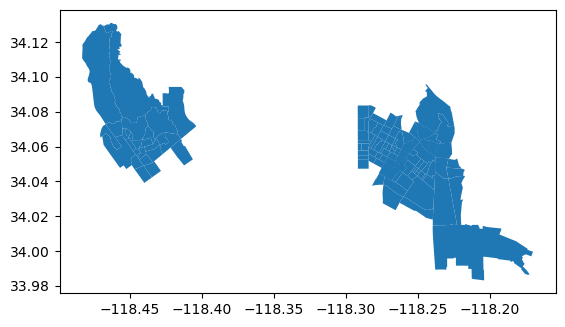

In [43]:
df_sn.plot()

In [44]:
clip_evic = evic_geo_match.clip(df_sn)
clip_evic = clip_evic[clip_evic['Cause'].isin(['Violation of the rental agreement or lease, Disorderly behavior/disturbing the peace (Nuisance)'])]

geopandas.geodataframe.GeoDataFrame

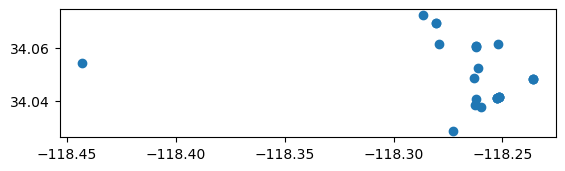

In [50]:
clip_evic.plot()
type(clip_evic)

In [46]:
# Grab average long and lat to center 
coords = df_sn.get_coordinates()
lon = []
lat = []
lon = coords['x']
lat = coords['y']
df_lon = lon.mean()
df_lat = lat.mean()
df_lat

34.06271017596205

In [51]:
m2 = fm.Map(location=(df_lat,df_lon), zoom_start=11)

fm.GeoJson(
    df_sn,
).add_to(m2)

fm.GeoJson(clip_evic).add_to(m2)

TypeError: Object of type Timestamp is not JSON serializable

In [63]:
evic_geo_match.info()
evic_geo_match = evic_geo_match[[
    'formatted_address',
    'latitude',
    'longitude',
    'type',
    'postcode',
    'Cause',
    'City',
    'geometry'
]]

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 46448 entries, 0 to 52191
Data columns (total 25 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Unnamed: 0         46448 non-null  int64         
 1   formatted_address  42560 non-null  object        
 2   latitude           42560 non-null  float64       
 3   longitude          42560 non-null  float64       
 4   accuracy           42560 non-null  object        
 5   google_place_id    42560 non-null  object        
 6   type               42560 non-null  object        
 7   postcode           41673 non-null  float64       
 8   input_string       46447 non-null  object        
 9   number_of_results  46448 non-null  int64         
 10  status             46448 non-null  object        
 11  Address_x          46448 non-null  object        
 12  Notice Date        46448 non-null  datetime64[ns]
 13  Date Received      46448 non-null  object        
 14  Evi

In [74]:
evic_geo_match.Cause.value_counts()

Cause
Non-payment of rent                                                                                                                                                                                    44303
Violation of the rental agreement or lease                                                                                                                                                               669
Non-payment of rent, Violation of the rental agreement or lease                                                                                                                                          441
Violation of the rental agreement or lease, Disorderly behavior/disturbing the peace (Nuisance)                                                                                                          178
Disorderly behavior/disturbing the peace (Nuisance)                                                                                                                           

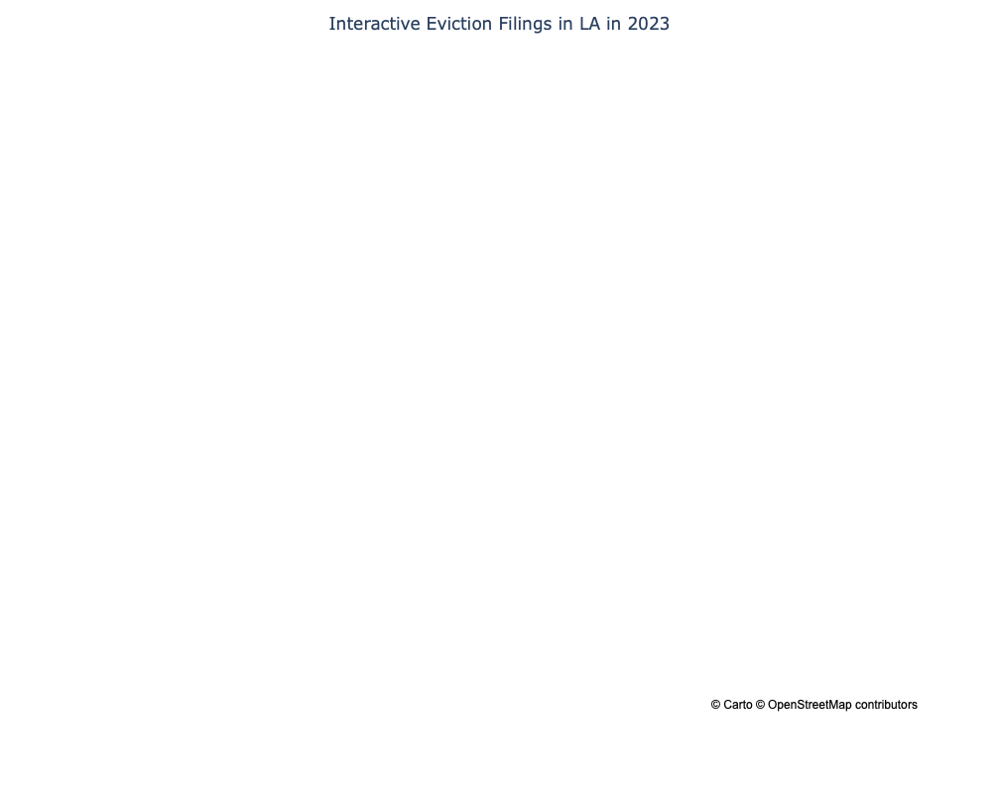

In [75]:
fig = px.scatter_mapbox(
    evic_geo_match,
    lat='latitude',
    lon='longitude',
    mapbox_style="carto-positron",
    labels={'Cause':'Non-payment of rent'}
)



# options on the layout
fig.update_layout(
    width = 800,
    height = 800,
    title = "Interactive Eviction Filings in LA in 2023",
    title_x=0.5 # aligns title to center
)

fig.show()

In [76]:
evictions_by_neighborhood = gpd.sjoin(n_ntdh_la,evic_geo_match)
evictions_by_neighborhood

,geometry,FIPS,name,units10_19,units20_more,total_renter,GRAPI_less_15,GRAPI_15_19,GRAPI_20_24,GRAPI_25_29,...,pct_race_two,no_high_diploma,index_right,formatted_address,latitude,longitude,type,postcode,Cause,City
0,"POLYGON ((-118.28491 34.25948, -118.28492 34.2...",06037101110,Tujunga,97,144,649,65,76,105,21,...,15.7,8.2,41371,"Fernglen Ave, Los Angeles, CA 91042, USA",34.257272,-118.294153,route,91042.0,Non-payment of rent,Los Angeles
1,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122,Tujunga,0,26,284,0,0,8,33,...,8,16.1,10813,"7455 Chanteclair Ct, Tujunga, CA 91042, USA",34.268252,-118.295078,premise,91042.0,Non-payment of rent,Los Angeles
1,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122,Sunland,0,26,284,0,0,8,33,...,8,16.1,10813,"7455 Chanteclair Ct, Tujunga, CA 91042, USA",34.268252,-118.295078,premise,91042.0,Non-payment of rent,Los Angeles
1,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122,Tujunga,0,26,284,0,0,8,33,...,8,16.1,45053,"11474 Dellmont Dr, Tujunga, CA 91042, USA",34.276641,-118.295461,premise,91042.0,Non-payment of rent,Los Angeles
1,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122,Sunland,0,26,284,0,0,8,33,...,8,16.1,45053,"11474 Dellmont Dr, Tujunga, CA 91042, USA",34.276641,-118.295461,premise,91042.0,Non-payment of rent,Los Angeles
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2057,"POLYGON ((-118.22227 33.80441, -118.22245 33.8...",06037578000,Wilmington,93,205,1147,57,182,103,116,...,12,35.5,46774,"1629 W Pacific Coast Hwy, Long Beach, CA 90810...",33.790077,-118.214417,street_address,90810.0,Non-payment of rent,WILMINGTON
2057,"POLYGON ((-118.22227 33.80441, -118.22245 33.8...",06037578000,Wilmington,93,205,1147,57,182,103,116,...,12,35.5,38818,"1635 W Pacific Coast Hwy, Long Beach, CA 90810...",33.790081,-118.214673,premise,90810.0,Non-payment of rent,WILMINGTON
2057,"POLYGON ((-118.22227 33.80441, -118.22245 33.8...",06037578000,Wilmington,93,205,1147,57,182,103,116,...,12,35.5,47410,"1645 W Pacific Coast Hwy, Long Beach, CA 90810...",33.790272,-118.214913,premise,90810.0,Non-payment of rent,WILMINGTON
2057,"POLYGON ((-118.22227 33.80441, -118.22245 33.8...",06037578000,Wilmington,93,205,1147,57,182,103,116,...,12,35.5,43398,"1645 W Pacific Coast Hwy, Long Beach, CA 90810...",33.790272,-118.214913,premise,90810.0,Non-payment of rent,WILMINGTON


In [77]:
eviction_count = evictions_by_neighborhood['name'].value_counts().reset_index(name='evictions_ct')

In [78]:
eviction_count

,name,evictions_ct
0,Downtown,9012
1,Koreatown,4413
2,Westlake,4352
3,Hollywood,3953
4,Winnetka,2363
...,...,...
109,Cypress Park,30
110,Beverly Crest,29
111,Bel-Air,24
112,Elysian Valley,22


In [79]:
neighborhoods1 = gpd.read_file("https://services5.arcgis.com/7nsPwEMP38bSkCjy/arcgis/rest/services/LA_Times_Neighborhoods/FeatureServer/0/query?outFields=*&where=1%3D1&f=geojson")

In [80]:
neighborhoods1 = neighborhoods1.merge(eviction_count,how='left',on='name')

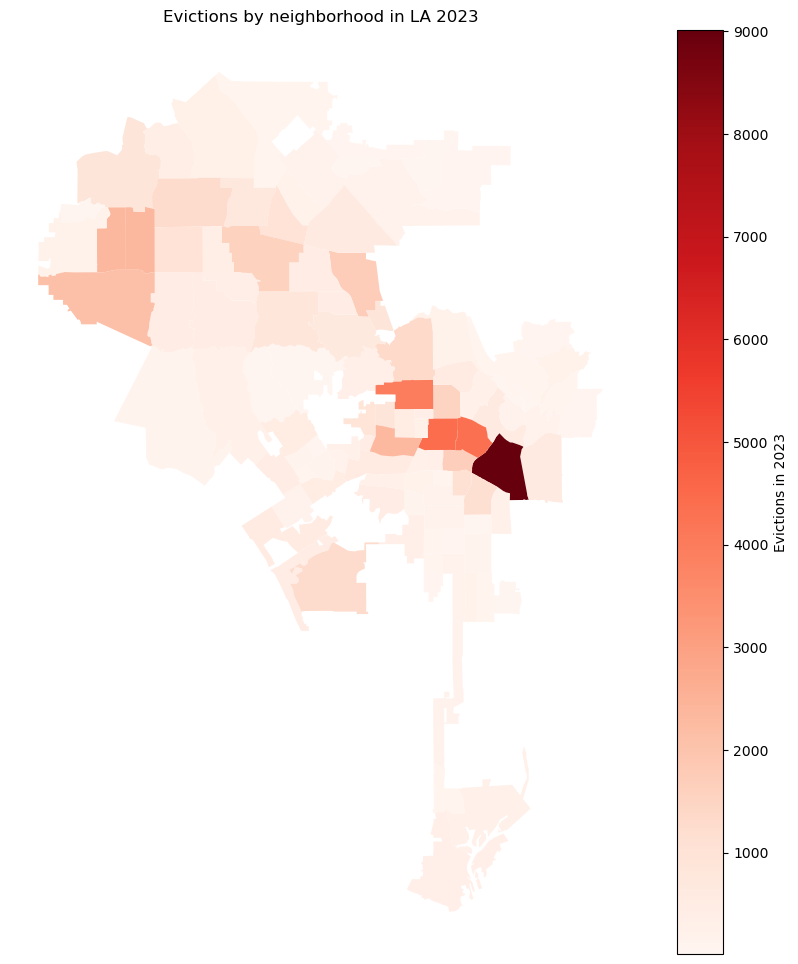

In [81]:

# Create the plot
fig, ax = plt.subplots(figsize=(12, 12))
neighborhoods1.plot(column='evictions_ct', legend=True, cmap='Reds', ax=ax,
                   # add legend keywords and orientation
                           legend_kwds={"label": "Evictions in 2023", "orientation": "vertical"},)
# turn x y axis off
ax.axis('off')

# add title
ax.set_title('Evictions by neighborhood in LA 2023')

# save figure as jpg
plt.savefig('data/evictions2023.jpg')